2022-03-08	<br/>
Erasmus student mobility <br/>
https://github.com/rfordatascience/tidytuesday/blob/master/data/2022/2022-03-08/readme.md

Map lines - Completed <br/>
Grouped by counts - Completed <br/>
Grouped by values - Completed 

https://plotly.com/python/lines-on-maps/

In [105]:
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
pio.renderers.default='jupyterlab'
import os

In [19]:
df = pd.read_csv('https://raw.githubusercontent.com/rfordatascience/tidytuesday/master/data/2022/2022-03-08/erasmus.csv')

In [20]:
df.head()

,project_reference,academic_year,mobility_start_month,mobility_end_month,mobility_duration,activity_mob,field_of_education,participant_nationality,education_level,participant_gender,...,participant_age,sending_country_code,sending_city,sending_organization,sending_organisation_erasmus_code,receiving_country_code,receiving_city,receiving_organization,receiving_organisation_erasmus_code,participants
0,2014-1-AT02-KA347-000139,2014-2015,2014-11,2014-11,1,National youth meetings,? Unknown ?,AT,??? - ? Unknown ?,Female,...,13,AT,Dornbirn,bOJA - Bundesweites Netzwerk Offene Jugendarbeit,-,AT,Dornbirn,bOJA - Bundesweites Netzwerk Offene Jugendarbeit,-,2
1,2014-1-AT02-KA347-000139,2014-2015,2014-11,2014-11,1,National youth meetings,? Unknown ?,AT,??? - ? Unknown ?,Female,...,14,AT,Dornbirn,bOJA - Bundesweites Netzwerk Offene Jugendarbeit,-,AT,Dornbirn,bOJA - Bundesweites Netzwerk Offene Jugendarbeit,-,3
2,2014-1-AT02-KA347-000139,2014-2015,2014-11,2014-11,1,National youth meetings,? Unknown ?,AT,??? - ? Unknown ?,Female,...,15,AT,Dornbirn,bOJA - Bundesweites Netzwerk Offene Jugendarbeit,-,AT,Dornbirn,bOJA - Bundesweites Netzwerk Offene Jugendarbeit,-,3
3,2014-1-AT02-KA347-000139,2014-2015,2014-11,2014-11,1,National youth meetings,? Unknown ?,AT,??? - ? Unknown ?,Male,...,14,AT,Dornbirn,bOJA - Bundesweites Netzwerk Offene Jugendarbeit,-,AT,Dornbirn,bOJA - Bundesweites Netzwerk Offene Jugendarbeit,-,4
4,2014-1-AT02-KA347-000139,2014-2015,2014-11,2014-11,1,National youth meetings,? Unknown ?,AT,??? - ? Unknown ?,Male,...,15,AT,Dornbirn,bOJA - Bundesweites Netzwerk Offene Jugendarbeit,-,AT,Dornbirn,bOJA - Bundesweites Netzwerk Offene Jugendarbeit,-,2


In [47]:
df.columns

Index(['project_reference', 'academic_year', 'mobility_start_month',
       'mobility_end_month', 'mobility_duration', 'activity_mob',
       'field_of_education', 'participant_nationality', 'education_level',
       'participant_gender', 'participant_profile', 'special_needs',
       'fewer_opportunities', 'group_leader', 'participant_age',
       'sending_country_code', 'sending_city', 'sending_organization',
       'sending_organisation_erasmus_code', 'receiving_country_code',
       'receiving_city', 'receiving_organization',
       'receiving_organisation_erasmus_code', 'participants'],
      dtype='object')

In [27]:
df_2019= df[df.academic_year=='2019-2020']

In [43]:
# Pulling the global coordinates 
# Special thanks to albertyw   : https://github.com/albertyw/avenews/blob/master/old/data/average-latitude-longitude-countries.csv
df_country = pd.read_csv('https://raw.githubusercontent.com/albertyw/avenews/master/old/data/average-latitude-longitude-countries.csv')

In [62]:
df_country.rename(columns={"ISO 3166 Country Code": "Country Code"},inplace=True)

In [63]:
df_sending_country_code =  df_country.add_suffix('_sending_country_code')
df_receiving_country_code=  df_country.add_suffix('_receiving_country_code')

In [64]:
df_sending_country_code.head()

,Country Code_sending_country_code,Country_sending_country_code,Latitude_sending_country_code,Longitude_sending_country_code
0,AD,Andorra,42.50,1.50
1,AE,United Arab Emirates,24.00,54.00
2,AF,Afghanistan,33.00,65.00
3,AG,Antigua and Barbuda,17.05,-61.80
4,AI,Anguilla,18.25,-63.17


In [100]:
# Filter the counts for opacity 
df_counts=pd.DataFrame()
df_counts[['participant_nationality','counts']]= df_2019.groupby(['participant_nationality']).count().reset_index()[['participant_nationality','project_reference']]
df_counts.head()

,participant_nationality,counts
0,-,1
1,AF,71
2,AL,70
3,AM,40
4,AO,3


In [101]:
# Merging everything together
full_df= df_2019.merge(df_sending_country_code,how='inner',left_on='sending_country_code', right_on='Country Code_sending_country_code')
full_df= full_df.merge(df_receiving_country_code,how='inner',left_on='receiving_country_code', right_on='Country Code_receiving_country_code')
full_df= full_df.merge(df_counts,how='inner',left_on='participant_nationality', right_on='participant_nationality')

In [108]:
# Baseline graph
fig = px.line_geo(full_df, locations="Country_sending_country_code",
                  color="Country_receiving_country_code", # "continent" is one of the columns of gapminder
                  locationmode = 'country names' ,
                  projection="orthographic")
fig.update_layout(title= "Where do students visit - Using Plotly Line Geo")

                  
fig.show()

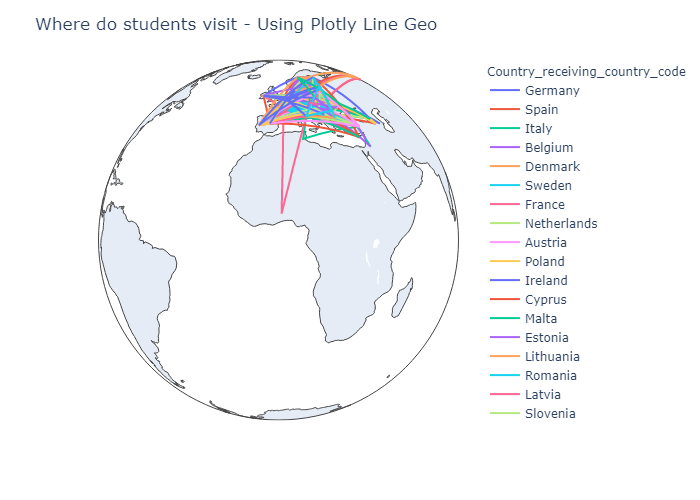

In [109]:
# Display Output in production
img_bytes = fig.to_image(format="png")
from IPython.display import Image
Image(img_bytes)

In [113]:
# With all users - With a gradient scale 
import plotly.graph_objects as go
import pandas as pd

fig = go.Figure()

# fig.add_trace(go.Scattergeo(
#     locationmode = 'country names' ,
#     hoverinfo = 'text',
#     text = full_df['company_location'],
#     lon=full_df['Longitude_bean_origin'],
#     lat=full_df['Latitude_bean_origin'],
#     mode = 'markers',
#     marker = dict(
#         size = 2,
#         color = 'rgb(255, 0, 0)',
#         line = dict(
#             width = 3,
#             color = 'rgba(68, 68, 68, 0)'
#         )
#     )))

flight_paths = []
for i in range(len(full_df)):
    fig.add_trace(
        go.Scattergeo(
          #  locations=full_df['company_location'],
            locationmode = 'country names' ,
            lon = [full_df['Longitude_sending_country_code'][i], full_df['Longitude_receiving_country_code'][i]],
            lat = [full_df['Latitude_sending_country_code'][i], full_df['Latitude_receiving_country_code'][i]],
            mode = 'lines',
            line = dict(width = 1,color = 'red'),
            opacity = float(full_df['counts'][i]) / float(full_df['counts'].max())
        )
    )

fig.update_layout(
    title_text = "Where do students visit - Scaled by number of visits",
    showlegend = False,
    geo = dict(
        showland = True,
        scope = 'europe',
        landcolor = 'rgb(243, 243, 243)',
        countrycolor = 'rgb(204, 204, 204)',
    ),
)

fig.show()

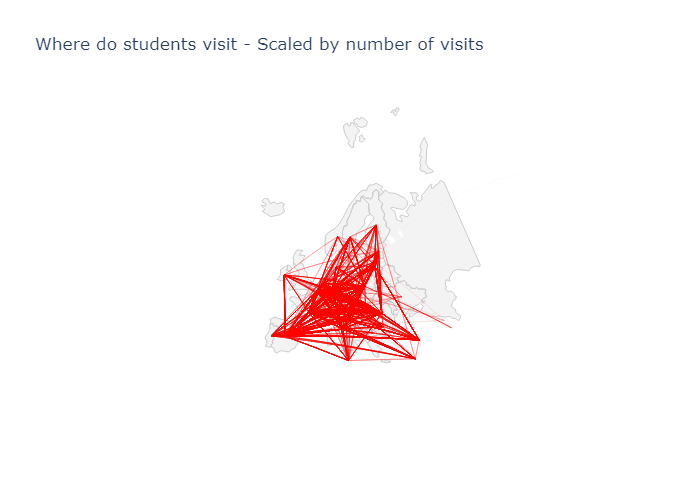

In [114]:
# Display Output in production
img_bytes = fig.to_image(format="png")
from IPython.display import Image
Image(img_bytes)

In [115]:
# Grouping users 
import plotly.graph_objects as go
import pandas as pd



fig = go.Figure()


flight_paths = []
for i in range(len(full_df)):
    fig.add_trace(
        go.Scattergeo(
            locationmode = 'country names',
            lon = [full_df['Longitude_sending_country_code'][i], full_df['Longitude_receiving_country_code'][i]],
            lat = [full_df['Latitude_sending_country_code'][i], full_df['Latitude_receiving_country_code'][i]],
            mode = 'lines',
            name=full_df['participant_nationality'][i],
            opacity = float(full_df['counts'][i]) / float(full_df['counts'].max()),
            line = dict(width = 1)
        )
    )

fig.update_layout(
    title_text =  "Where do students visit - Grouped by number of student nationality",
    showlegend = False,
    geo = dict(
        scope = 'europe',
        projection_type = 'azimuthal equal area',
        showland = True,
        landcolor = 'rgb(243, 243, 243)',
        countrycolor = 'rgb(204, 204, 204)',
    ),
)
# Set marker line color to same color as marker for each trace
# for i, data in enumerate(fig['data']):
#     fig.update_traces(marker_color=data['line']['color'],
#                       selector=dict(name=data['name']))

fig.show()

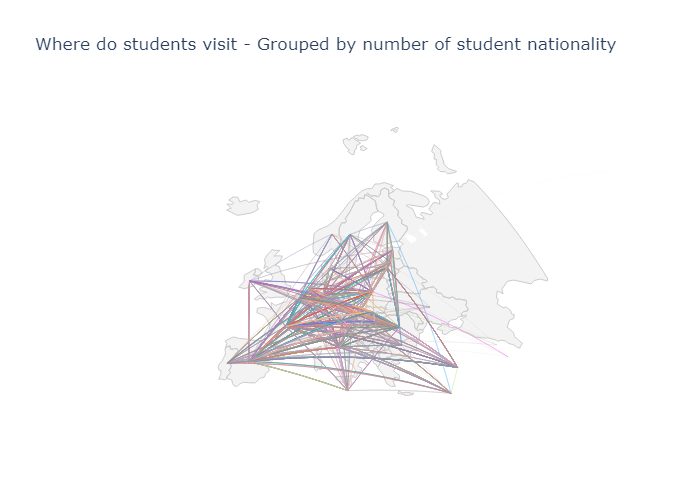

In [116]:
# Display Output in production
img_bytes = fig.to_image(format="png")
from IPython.display import Image
Image(img_bytes)